# **PROYECTO FINAL**

# **Grupo: 3**

Integrantes:
- Juan Marcos Miranda Nina
- Roberto Carlos Ascencio Andrade
- Percy Pedro Fuentes Ramos
- Karina Raquel Romero Flores


### **1. Ingestar datos desde al menos dos fuentes distintas (ej. API + CSV, o Scraping + Base de datos).**

In [ ]:
# DATASET GENERADO CON LA API DE OPEN-METEO

!pip install requests pandas tqdm

import requests
import pandas as pd
from datetime import datetime, timedelta
from tqdm import tqdm

# Coordenadas de La Paz, Bolivia
LAT = -16.5     # aproximadamente
LON = -68.13    # aproximadamente

def fetch_historical(lat, lon, start_date, end_date, variables, timezone="auto"):
    """
    Llama la API de Open-Meteo Historical Weather para un rango de fechas.
    Retorna un DataFrame con los datos horarios.

    variables: lista de nombres de variables,
        e.g. ["temperature_2m", "relativehumidity_2m", "pressure_msl", "windspeed_10m", "winddirection_10m", "precipitation"]
    """
    # Formato de fechas: “YYYY-MM-DD” para la API
    start_str = start_date.strftime("%Y-%m-%d")
    end_str = end_date.strftime("%Y-%m-%d")
    # llamando a la URL
    base = "https://archive-api.open-meteo.com/v1/archive"
    params = {
        "latitude": lat,
        "longitude": lon,
        "start_date": start_str,
        "end_date": end_str,
        "hourly": ",".join(variables),
        "timezone": timezone
    }
    response = requests.get(base, params=params)
    if response.status_code != 200:
        print("Error al consultar API:", response.status_code, response.text)
        return None
    return response.json()

def build_full_dataset(lat, lon, start_date, end_date, variables, timezone="auto", chunk_days=30):
    """
    Para no pedir fechas enormes de una sola vez, hacemos trozos del tamaño chunk_days.
    Devuelve DataFrame concatenado con todos los trozos.
    """
    all_dfs = []
    cur = start_date
    while cur < end_date:
        chunk_end = min(end_date, cur + timedelta(days=chunk_days))
        print(f"Fetching chunk: {cur.date()} → {chunk_end.date()}")
        j = fetch_historical(lat, lon, cur, chunk_end, variables, timezone=timezone)
        if j is None:
            print("Fallo en este trozo, se omite:", cur, "->", chunk_end)
        else:
            # convertir JSON a DataFrame
            # j["hourly"]["time"] es lista de timestamps, j["hourly"][var] es lista paralela
            df = pd.DataFrame(j["hourly"])
            # la API devuelve columnas: “time”, plus variables
            # convertir time a datetime
            df["time"] = pd.to_datetime(df["time"])
            all_dfs.append(df)
        cur = chunk_end + timedelta(days=1)
    if not all_dfs:
        return None
    df_all = pd.concat(all_dfs, ignore_index=True)
    return df_all

def main():
    # definir rango completo
    start = datetime(2020, 1, 1)
    end = datetime(2025, 9, 26)   # lo dejamos hasta 2025-09-26


    variables = [
        "temperature_2m",
        "relativehumidity_2m",
        "pressure_msl",
        "windspeed_10m",
        "winddirection_10m",
        "precipitation"
    ]

    df = build_full_dataset(LAT, LON, start, end, variables, timezone="auto", chunk_days=60)
    if df is None:
        print("No se obtuvo ningún dato.")
        return

    # renombrando columnas
    df = df.rename(columns={
        "time": "fecha_hora",
        "temperature_2m": "temp_C",
        "relativehumidity_2m": "humidity_pct",
        "pressure_msl": "pressure_hPa",
        "windspeed_10m": "wind_speed_mps",
        "winddirection_10m": "wind_dir_deg",
        "precipitation": "precip_mm"
    })

    # reordenar columnas
    cols = ["fecha_hora", "temp_C", "humidity_pct", "pressure_hPa", "wind_speed_mps", "wind_dir_deg", "precip_mm"]
    df = df[cols]

    # mostrar primeros registros
    print(df.head())
    print("Cantidad de registros:", len(df))

    # guardar como CSV
    filename = "la_paz_weather_2020_2025sep27.csv"
    df.to_csv(filename, index=False)
    print("Guardado en:", filename)

if __name__ == "__main__":
    main()

Fetching chunk: 2020-01-01 → 2020-03-01
Fetching chunk: 2020-03-02 → 2020-05-01
Fetching chunk: 2020-05-02 → 2020-07-01
Fetching chunk: 2020-07-02 → 2020-08-31
Fetching chunk: 2020-09-01 → 2020-10-31
Fetching chunk: 2020-11-01 → 2020-12-31
Fetching chunk: 2021-01-01 → 2021-03-02
Fetching chunk: 2021-03-03 → 2021-05-02
Fetching chunk: 2021-05-03 → 2021-07-02
Fetching chunk: 2021-07-03 → 2021-09-01
Fetching chunk: 2021-09-02 → 2021-11-01
Fetching chunk: 2021-11-02 → 2022-01-01
Fetching chunk: 2022-01-02 → 2022-03-03
Fetching chunk: 2022-03-04 → 2022-05-03
Fetching chunk: 2022-05-04 → 2022-07-03
Fetching chunk: 2022-07-04 → 2022-09-02
Fetching chunk: 2022-09-03 → 2022-11-02
Fetching chunk: 2022-11-03 → 2023-01-02
Fetching chunk: 2023-01-03 → 2023-03-04
Fetching chunk: 2023-03-05 → 2023-05-04
Fetching chunk: 2023-05-05 → 2023-07-04
Fetching chunk: 2023-07-05 → 2023-09-03
Fetching chunk: 2023-09-04 → 2023-11-03
Fetching chunk: 2023-11-04 → 2024-01-03
Fetching chunk: 2024-01-04 → 2024-03-04


## Dataset unificado (Dataset Api + Base de datos csv)

In [ ]:
import pandas as pd

df_unificado = pd.read_csv("/content/dataset_unificado.csv")
print(df_unificado.head())

FileNotFoundError: [Errno 2] No such file or directory: '/content/dataset_unificado.csv'

# **2. Asegurar calidad de datos (verificación, validación, diccionario de datos, profiling)..**


#	Diccionario de datos
1	fecha_hora	fecha y hora del registrod e la temperatura

2	temp_C	Temperatura

3 tmin Temperatura mínima

4 tmin Temperatura máxima

5 precip_mm precipitación en mm

6	snow	Profundidad de la Nieve

7 wind_dir_deg	Dirección del viento

8 wind_speed_mps Velocidad del viento

9	wpgt	Ráfaga de Viento

10 pressure_hPa Presión

11 departamento Departamento   

12 humidity_pct Humedad    

13 temp_category categoria temperatura    

14 rain_category Categoria de lluvi    

15 precipitacion Precipitaciíon   

16 temperatura Temperatura     

17 wind_category Categoria del viento   

18 velocidad_del_viento Velocidad del viento

19 pressure_category Categoria presión

20 presion_atmosferica Presion Atmosferica

21 año    Año

22 mes    mes

23 dia    Día

24 dia_de_la_semana Dia Semana
      
27 estacion_del_año

28 hour  Hora          

33 day_period Día periodico      

34 momento_del_dia Momento del día


##*Data profiling*

El data profiling o perfilado de datos sirve para examinar y comprender la calidad, el contenido y la estructura de los conjuntos de datos, identificando errores, valores nulos y patrones inusuales, facilitando así la toma de decisiones informadas.

## Ydata-profiling
  (anteriormente pandas-profiling) es una biblioteca de Python que genera automáticamente informes detallados en formato HTML para el análisis exploratorio de datos (EDA) de dataframes de pandas

In [ ]:
pip install -U ydata-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.3/399.3 kB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 20.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 54.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.7/679.7 kB 43.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.3/37.3 MB 39.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 2.9 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.16.2
    Uninstalling scipy-1.16.2:
      Successfully uninstalled scipy-1.16.2


In [ ]:
import pandas as pd
from ydata_profiling import ProfileReport

df = pd.read_csv('data_set_3_clasificacion_proceso_datos.csv')
profile = ProfileReport(df, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 34/34 [00:04<00:00,  7.40it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
print("\n Información del dataset")
df.info()


 Información del dataset
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59125 entries, 0 to 59124
Data columns (total 34 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fecha_hora            59125 non-null  object 
 1   temp_C                59125 non-null  float64
 2   tmin                  8442 non-null   float64
 3   tmax                  8438 non-null   float64
 4   precip_mm             59125 non-null  float64
 5   snow                  59125 non-null  float64
 6   wind_dir_deg          59125 non-null  float64
 7   wind_speed_mps        59125 non-null  float64
 8   wpgt                  332 non-null    float64
 9   pressure_hPa          59125 non-null  float64
 10  departamento          59125 non-null  object 
 11  humidity_pct          59125 non-null  float64
 12  temp_category         59125 non-null  object 
 13  rain_category         59125 non-null  object 
 14  precipitacion         59125 non-null  object

In [ ]:
print("Número de fila y columnas")
df.shape

Número de fila y columnas


(59125, 34)

# **3. Clasificar y procesar datos (etiquetado o taxonomía simple, transformación).**


In [ ]:
import pandas as pd

# ID del archivo (lo que está entre /d/ y /view)
file_id = '1fg-uLRKMskHMrNNmm9Zo46J2_WYTLCrm'

# URL directa para descargar desde Drive
url = f'https://drive.google.com/uc?id={file_id}'

# Leer el CSV
df = pd.read_csv(url)

# Mostrar las primeras filas
df.head()

,fecha_hora,temp_C,tmin,tmax,precip_mm,snow,wind_dir_deg,wind_speed_mps,wpgt,pressure_hPa,tsun,departamento,humidity_pct
0,2023-01-01 00:00:00,21.4,16.0,32.2,1.3,NaN,NaN,11.3,NaN,1021.6,NaN,cocha,NaN
1,2023-01-02 00:00:00,20.0,16.7,32.2,14.0,NaN,NaN,11.5,NaN,1022.6,NaN,cocha,NaN
2,2023-01-03 00:00:00,19.1,13.4,29.1,0.5,NaN,NaN,10.0,NaN,1018.8,NaN,cocha,NaN
3,2023-01-04 00:00:00,14.4,11.5,18.0,14.6,NaN,NaN,11.8,NaN,1023.9,NaN,cocha,NaN
4,2023-01-05 00:00:00,15.9,10.2,27.2,6.4,NaN,NaN,8.5,NaN,1025.0,NaN,cocha,NaN


**Temperatura**
- **Muy fría:** < 0°C
- **Fría:** 0–10°C
- **Templada:** 10–20°C
- **Cálida:** 20–30°C
- **Calurosa:** >30°C

In [ ]:
def clasificar_temp(t):
    if t < 0:
        return "Muy fría"
    elif t < 10:
        return "Fría"
    elif t < 20:
        return "Templada"
    elif t < 30:
        return "Cálida"
    else:
        return "Calurosa"

df['temperatura'] = df['temp_C'].apply(clasificar_temp)
# Ver primeras filas
df[['fecha_hora', 'temp_C', 'temperatura']].head(15)

,fecha_hora,temp_C,temperatura
0,2023-01-01 00:00:00,21.4,Cálida
1,2023-01-02 00:00:00,20.0,Cálida
2,2023-01-03 00:00:00,19.1,Templada
3,2023-01-04 00:00:00,14.4,Templada
4,2023-01-05 00:00:00,15.9,Templada
5,2023-01-06 00:00:00,18.8,Templada
6,2023-01-07 00:00:00,20.0,Cálida
7,2023-01-08 00:00:00,18.8,Templada
8,2023-01-09 00:00:00,18.4,Templada
9,2023-01-10 00:00:00,20.4,Cálida


**Precipitación (prcp)**

- **0 mm:** Sin lluvia
- **0–5 mm:** Lluvia ligera
- **5–20 mm:** Moderada
- **20–50 mm:** Intensa
- **> 50 mm:** Tormenta

In [ ]:
# Clasificación de precipitación
def clasificar_lluvia(p):
    if p == 0:
        return "Sin lluvia"
    elif p <= 5:
        return "Lluvia ligera"
    elif p <= 20:
        return "Moderada"
    elif p <= 50:
        return "Intensa"
    else:
        return "Tormenta"

df['precipitacion'] = df['precip_mm'].apply(clasificar_lluvia)

# Ver primeras filas
df[['fecha_hora', 'precip_mm', 'precipitacion']].head(15)

,fecha_hora,precip_mm,precipitacion
0,2023-01-01 00:00:00,1.3,Lluvia ligera
1,2023-01-02 00:00:00,14.0,Moderada
2,2023-01-03 00:00:00,0.5,Lluvia ligera
3,2023-01-04 00:00:00,14.6,Moderada
4,2023-01-05 00:00:00,6.4,Moderada
5,2023-01-06 00:00:00,0.5,Lluvia ligera
6,2023-01-07 00:00:00,0.0,Sin lluvia
7,2023-01-08 00:00:00,0.0,Sin lluvia
8,2023-01-09 00:00:00,1.8,Lluvia ligera
9,2023-01-10 00:00:00,0.3,Lluvia ligera


**Velocidad del viento**
| Beaufort | Rango (m/s)   | Clasificación        |
|----------|--------------|----------------------|
| 0        | 0 – 0.2      | Calma                |
| 1        | 0.3 – 1.5    | Ventolina ligera     |
| 2        | 1.6 – 3.3    | Brisa ligera         |
| 3        | 3.4 – 5.4    | Brisa suave          |
| 4        | 5.5 – 7.9    | Brisa moderada       |
| 5        | 8.0 – 10.7   | Brisa fresca         |
| 6        | 10.8 – 13.8  | Brisa fuerte         |
| 7        | 13.9 – 17.1  | Viento duro          |
| 8        | 17.2 – 20.7  | Temporal             |
| 9        | 20.8 – 24.4  | Temporal fuerte      |
| 10       | 24.5 – 28.4  | Temporal duro        |
| 11       | 28.5 – 32.6  | Borrasca violenta    |
| 12       | > 32.6       | Huracán              |


In [ ]:
# Clasificación de velocidad del viento según Beaufort
def clasificar_viento(v):
    if v <= 0.2:
        return "Calma"
    elif v <= 1.5:
        return "Ventolina ligera"
    elif v <= 3.3:
        return "Brisa ligera"
    elif v <= 5.4:
        return "Brisa suave"
    elif v <= 7.9:
        return "Brisa moderada"
    elif v <= 10.7:
        return "Brisa fresca"
    elif v <= 13.8:
        return "Brisa fuerte"
    elif v <= 17.1:
        return "Viento duro"
    elif v <= 20.7:
        return "Temporal"
    elif v <= 24.4:
        return "Temporal fuerte"
    elif v <= 28.4:
        return "Temporal duro"
    elif v <= 32.6:
        return "Borrasca violenta"
    else:
        return "Huracán"

df['velocidad_del_viento'] = df['wind_speed_mps'].apply(clasificar_viento)
# Ver primeras filas
df[['fecha_hora', 'wind_speed_mps', 'velocidad_del_viento']].head(15)

,fecha_hora,wind_speed_mps,velocidad_del_viento
0,2023-01-01 00:00:00,11.3,Brisa fuerte
1,2023-01-02 00:00:00,11.5,Brisa fuerte
2,2023-01-03 00:00:00,10.0,Brisa fresca
3,2023-01-04 00:00:00,11.8,Brisa fuerte
4,2023-01-05 00:00:00,8.5,Brisa fresca
5,2023-01-06 00:00:00,9.3,Brisa fresca
6,2023-01-07 00:00:00,10.1,Brisa fresca
7,2023-01-08 00:00:00,13.6,Brisa fuerte
8,2023-01-09 00:00:00,9.4,Brisa fresca
9,2023-01-10 00:00:00,8.9,Brisa fresca


**Presión atmosférica**

- Baja presión (< 1000 hPa) → Posible mal tiempo
- Normal (1000–1020 hPa)
- Alta presión (> 1020 hPa) → Tiempo estable

In [ ]:
# Clasificación de la presión atmosférica
def clasificar_presion(p):
    if p < 1000:
        return "Baja presión (posible mal tiempo)"
    elif p <= 1020:
        return "Presión normal"
    else:
        return "Alta presión (tiempo estable)"

df['presion_atmosferica'] = df['pressure_hPa'].apply(clasificar_presion)
# Ver primeras filas
df[['fecha_hora', 'pressure_hPa', 'presion_atmosferica']].head(15)

,fecha_hora,pressure_hPa,presion_atmosferica
0,2023-01-01 00:00:00,1021.6,Alta presión (tiempo estable)
1,2023-01-02 00:00:00,1022.6,Alta presión (tiempo estable)
2,2023-01-03 00:00:00,1018.8,Presión normal
3,2023-01-04 00:00:00,1023.9,Alta presión (tiempo estable)
4,2023-01-05 00:00:00,1025.0,Alta presión (tiempo estable)
5,2023-01-06 00:00:00,1024.8,Alta presión (tiempo estable)
6,2023-01-07 00:00:00,1025.5,Alta presión (tiempo estable)
7,2023-01-08 00:00:00,1025.1,Alta presión (tiempo estable)
8,2023-01-09 00:00:00,1023.2,Alta presión (tiempo estable)
9,2023-01-10 00:00:00,1021.7,Alta presión (tiempo estable)


**Extraer componentes temporales**

- Año (year)
- Mes (month)
- Día (day)
- Día de la semana (weekday) → lunes, martes, …
- Estación del año (season)

In [ ]:
# Asegurar que la columna es datetime
df['fecha_hora'] = pd.to_datetime(df['fecha_hora'])

# Nuevas columnas
df['año'] = df['fecha_hora'].dt.year
df['mes'] = df['fecha_hora'].dt.month
df['dia'] = df['fecha_hora'].dt.day
df['dia_de_la_semana'] = df['fecha_hora'].dt.day_name()   # nombre del día

df[['fecha_hora','año', 'mes', 'dia','dia_de_la_semana']].head(15)

,fecha_hora,año,mes,dia,dia_de_la_semana
0,2023-01-01,2023,1,1,Sunday
1,2023-01-02,2023,1,2,Monday
2,2023-01-03,2023,1,3,Tuesday
3,2023-01-04,2023,1,4,Wednesday
4,2023-01-05,2023,1,5,Thursday
5,2023-01-06,2023,1,6,Friday
6,2023-01-07,2023,1,7,Saturday
7,2023-01-08,2023,1,8,Sunday
8,2023-01-09,2023,1,9,Monday
9,2023-01-10,2023,1,10,Tuesday


**Clasificar por estaciones del año**

- Verano: Dic–Feb
- Otoño: Mar–May
- Invierno: Jun–Ago
- Primavera: Sep–Nov

In [ ]:
def asignar_estacion(mes):
    if mes in [12,1,2]:
        return "Verano"
    elif mes in [3,4,5]:
        return "Otoño"
    elif mes in [6,7,8]:
        return "Invierno"
    else:
        return "Primavera"

df['estacion_del_año'] = df['mes'].apply(asignar_estacion)
df[['fecha_hora','estacion_del_año']].head(15)

,fecha_hora,estacion_del_año
0,2023-01-01,Verano
1,2023-01-02,Verano
2,2023-01-03,Verano
3,2023-01-04,Verano
4,2023-01-05,Verano
5,2023-01-06,Verano
6,2023-01-07,Verano
7,2023-01-08,Verano
8,2023-01-09,Verano
9,2023-01-10,Verano


**Clasificación por momento del día**

- Madrugada: 0–6h
- Mañana: 6–12h
- Tarde: 12–18h
- Noche: 18–24h

In [ ]:
df['hour'] = df['fecha_hora'].dt.hour

def clasificar_momento(h):
    if 0 <= h < 6:
        return "Madrugada"
    elif 6 <= h < 12:
        return "Mañana"
    elif 12 <= h < 18:
        return "Tarde"
    else:
        return "Noche"

df['momento_del_dia'] = df['hour'].apply(clasificar_momento)
df[['fecha_hora','momento_del_dia']].head(15)

**Exportar en csv**

In [ ]:
# Exportar a CSV
df.to_csv("data_set_3_clasificacion_proceso_datos.csv", index=False, encoding="utf-8")


# **4. Construir un pipeline orquestado (Airflow) con al menos 3 tareas conectadas.**


In [ ]:
import pandas as pd

def extract(path):
    return pd.read_csv(path)

def transform(df):
    df = df.drop_duplicates()
    df['Precio'] = pd.to_numeric(df['Precio'], errors='coerce')
    df['Total'] = df['Precio'] * df['Cantidad']
    return df.dropna(subset=['Producto'])

def load(df, output_path):
    df.to_csv(output_path, index=False)

# Pipeline completo
df = extract('ventas.csv')
df = transform(df)
load(df, 'ventas_limpio.csv')


# **5. Almacenar datos en un repositorio estructurado (CSV limpio, SQLite, PostgreSQL o similar).**


In [ ]:
import sqlite3
import pandas as pd

# Conectar (crea el archivo si no existe)
conn = sqlite3.connect("data_set_3.db")

# Guardar df en una tabla (reemplaza si ya existe)
df.to_sql("clasificacion_proceso_datos", conn, if_exists="replace", index=False)

print("✅ Guardado en SQLite -> data_set_3.db / tabla: clasificacion_proceso_datos")

In [ ]:
pd.read_sql("SELECT * FROM clasificacion_proceso_datos LIMIT 5", conn)


In [ ]:
import pandas as pd
import random
from datetime import datetime, timedelta

# -------------------------
# Generar datos de ejemplo
# -------------------------
num_filas = 50  # cantidad de registros de ventas

productos = ['Laptop', 'Monitor', 'Teclado', 'Mouse', 'Impresora', 'Tablet']
categorias = ['Electrónica', 'Accesorios', 'Periféricos']
clientes = ['Cliente A', 'Cliente B', 'Cliente C', 'Cliente D']

# Generar fechas aleatorias dentro del último mes
fecha_inicio = datetime.now() - timedelta(days=30)
fechas = [fecha_inicio + timedelta(days=random.randint(0, 30)) for _ in range(num_filas)]

# Crear DataFrame
df_ventas = pd.DataFrame({
    'Fecha': [f.date() for f in fechas],
    'Producto': [random.choice(productos) for _ in range(num_filas)],
    'Categoría': [random.choice(categorias) for _ in range(num_filas)],
    'Precio': [round(random.uniform(10, 1000), 2) for _ in range(num_filas)],
    'Cantidad': [random.randint(1, 5) for _ in range(num_filas)],
    'Cliente': [random.choice(clientes) for _ in range(num_filas)]
})

# Guardar CSV
df_ventas.to_csv('ventas.csv', index=False)
print("✅ Archivo 'ventas.csv' generado con éxito")
df_ventas.head()


In [ ]:
!pip install airflow

In [ ]:
from airflow import DAG
from airflow.operators.python_operator import PythonOperator
from datetime import datetime

# 1️⃣ Funciones de cada tarea
def extract():
    import pandas as pd
    df = pd.read_csv('ventas.csv')
    df.to_csv('/tmp/extracted.csv', index=False)

def transform():
    import pandas as pd
    df = pd.read_csv('/tmp/extracted.csv')
    df['Total'] = df['Precio'] * df['Cantidad']
    df.to_csv('/tmp/transformed.csv', index=False)

def load():
    import pandas as pd
    df = pd.read_csv('/tmp/transformed.csv')
    df.to_csv('/tmp/final_ventas.csv', index=False)

# 2️⃣ Definir el DAG
default_args = {
    'owner': 'airflow',
    'start_date': datetime(2025, 10, 1),
    'retries': 1
}

dag = DAG(
    'etl_pipeline_ventas',
    default_args=default_args,
    description='Pipeline ETL de ventas automatizado',
    schedule_interval='@daily',  # Se ejecuta diariamente
)

# 3️⃣ Definir las tareas
t1 = PythonOperator(task_id='extract', python_callable=extract, dag=dag)
t2 = PythonOperator(task_id='transform', python_callable=transform, dag=dag)
t3 = PythonOperator(task_id='load', python_callable=load, dag=dag)

# 4️⃣ Definir el flujo
t1 >> t2 >> t3  # Primero extract, luego transform, luego load


In [ ]:
!pip install apache-airflow


# **6. Diseñar una arquitectura de solución moderna (batch o streaming) y justificar la elección.**


## <a style="font-size: 50pt; font-weight: bold">Recolectar, procesar y analizar datos climáticos históricos y en tiempo real para, Bolivia, usando una arquitectura mixta de batch + streaming.
</a>

## <a style="font-size: 50pt; font-weight: bold">La elección de una arquitectura mixta (Batch + Streaming) para datos climáticos orientados al turismo en Bolivia se justifica por varias razones técnicas y operativas:
- Necesidad de datos históricos y en tiempo real
- Ventajas de la arquitectura Batch
- Ventajas de la arquitectura Streaming
- Sinergia Batch + Streaming
</a>




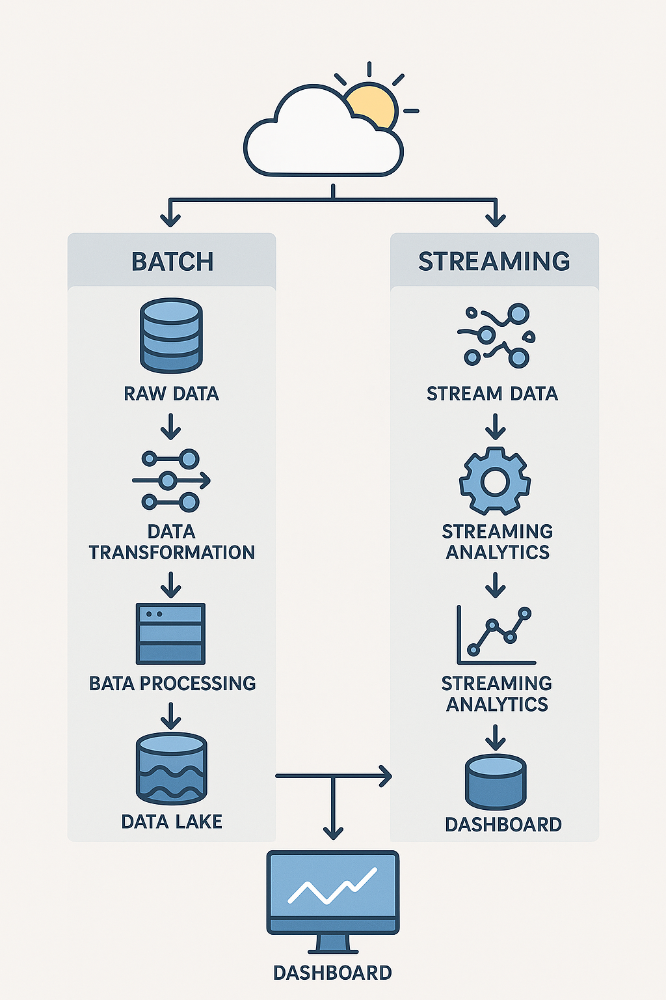

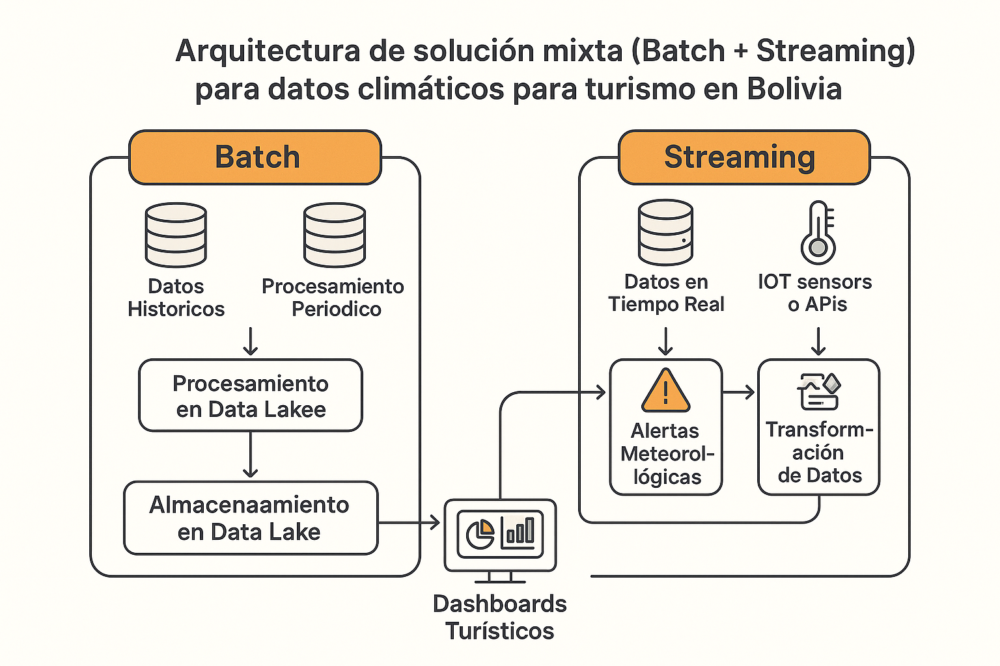

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# **7. Publicar un Data Quality Report y documentación del proceso.**

In [ ]:
import pandas as pd
import sqlite3

# Conexión a la base
conn = sqlite3.connect("data_set_3.db")

# Cargar toda la tabla (o solo una parte si es muy grande)
df = pd.read_sql("SELECT * FROM clasificacion_proceso_datos", conn)

print("✅ Datos cargados desde SQLite:", df.shape)
df.head(3)


In [ ]:
import pandas as pd
import numpy as np

def data_quality_report(df):
    rep = pd.DataFrame(index=df.columns)
    rep["% Nulos"] = (df.isna().sum() / len(df) * 100).round(2)
    rep["Valores únicos"] = df.nunique()
    rep["Duplicados"] = "N/A"
    rep.iloc[0, rep.columns.get_loc("Duplicados")] = df.duplicated().sum()

    # Reglas de validación por columna (ajusta a tus nombres reales)
    rules = {
        "temp_C":         lambda s: s.between(-30, 45),
        "tmin":           lambda s: s.between(-40, 40),
        "tmax":           lambda s: s.between(-20, 55),
        "precip_mm":      lambda s: s.ge(0),                # precipitación no negativa
        "wind_dir_deg":   lambda s: s.between(0, 360),      # dirección 0–360
        "wind_speed_mps": lambda s: s.between(0, 60),       # 60 m/s ~ 216 km/h
        "wpgt":           lambda s: s.between(0, 80),       # rachas máximas
        "pressure_hPa":   lambda s: s.between(800, 1100),   # presión plausible
        "humidity_pct":   lambda s: s.between(0, 100),      # 0–100%
        "tsun":           lambda s: s.between(0, 24),       # horas de sol al día
    }

    compl = {}
    for col in df.columns:
        s = df[col]
        if col in rules and pd.api.types.is_numeric_dtype(s):
            mask = s.notna()
            compl[col] = (rules[col](s[mask]).mean() * 100) if mask.any() else np.nan
        elif pd.api.types.is_numeric_dtype(s):
            # sin regla específica, usa cuantiles 1–99% como proxy
            q1, q99 = s.quantile([0.01, 0.99])
            mask = s.notna()
            compl[col] = ((s[mask] >= q1) & (s[mask] <= q99)).mean() * 100 if mask.any() else np.nan
        else:
            compl[col] = 99.0

    rep["% Cumplimiento"] = pd.Series(compl).round(2)
    rep["Reglas cumplidas"] = np.where(rep["% Cumplimiento"] >= 90, "✅ Cumple", "❌ (fuera de rango)")
    rep.insert(0, "Columna", rep.index)
    rep = rep.reset_index(drop=True)
    return rep

reporte = data_quality_report(df)
reporte.head(20)


,Columna,% Nulos,Valores únicos,Duplicados,% Cumplimiento,Reglas cumplidas
0,fecha_hora,0.00,50328,0,99.00,✅ Cumple
1,temp_C,0.63,356,N/A,100.00,✅ Cumple
2,tmin,85.72,360,N/A,100.00,✅ Cumple
3,tmax,85.73,318,N/A,100.00,✅ Cumple
4,precip_mm,0.97,343,N/A,100.00,✅ Cumple
5,snow,99.99,2,N/A,83.33,❌ (fuera de rango)
6,wind_dir_deg,14.92,360,N/A,100.00,✅ Cumple
7,wind_speed_mps,0.74,386,N/A,100.00,✅ Cumple
8,wpgt,99.44,34,N/A,100.00,✅ Cumple
9,pressure_hPa,2.24,398,N/A,100.00,✅ Cumple


In [ ]:
!pip install -q ipywidgets==8.1.5 plotly==5.23.0

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.8/139.8 kB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 96.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 62.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 75.7 MB/s eta 0:00:00


In [ ]:
# =======================================================
# DASHBOARD ÚNICO (2x3) CON DROPDOWN DE DEPARTAMENTO
# =======================================================
import pandas as pd, numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio

# Renderer robusto (Colab/Jupyter)
try:
    from google.colab import output
    output.enable_custom_widget_manager()
    pio.renderers.default = "colab"
except Exception:
    pio.renderers.default = "notebook_connected"  # prueba "plotly_mimetype" si fuera necesario

# ---------- 0) Normalización mínima ----------
assert 'fecha_hora' in df.columns, "df no tiene 'fecha_hora'"
df = df.copy()
df['fecha_hora'] = pd.to_datetime(df['fecha_hora'], errors='coerce')
df['fecha'] = df['fecha_hora'].dt.date

# Detectar columna de ubicación
ubicacion_col = None
for cand in ['departamento','Departamento','ciudad','Ciudad','region','Región','provincia','Provincia']:
    if cand in df.columns:
        ubicacion_col = cand
        break
assert ubicacion_col is not None, "No encuentro columna de ubicación (departamento/ciudad/region)"

# Asegurar numéricos básicos
for c in ['temp_C','precip_mm','wind_speed_mps','pressure_hPa','tsun']:
    if c in df.columns:
        df[c] = pd.to_numeric(df[c], errors='coerce')

# ---------- 1) Órdenes de categorías ----------
orden_temp   = ["Muy fría","Fría","Templada","Cálida","Calurosa"]
orden_lluvia = ["Sin lluvia","Lluvia ligera","Moderada","Intensa","Tormenta"]
orden_viento = ["Calma","Ventolina ligera","Brisa ligera","Brisa suave","Brisa moderada",
                "Brisa fresca","Brisa fuerte","Viento duro","Temporal","Temporal fuerte",
                "Temporal duro","Borrasca violenta","Huracán"]
orden_pres   = ["Baja presión (posible mal tiempo)","Presión normal","Alta presión (tiempo estable)"]
orden_sol    = ["Día nublado","Parcialmente soleado","Muy soleado"]

# ---------- 2) Lista de departamentos ----------
departamentos = sorted(df[ubicacion_col].dropna().astype(str).unique().tolist())
departamentos = ['Todos'] + departamentos

# ---------- 3) Armar vistas por depto ----------
def counts_safe(serie, orden):
    if serie is None:
        return pd.Series([0]*len(orden), index=orden)
    vc = serie.value_counts()
    return vc.reindex(orden).fillna(0)

views = {}
for depto in departamentos:
    dd = df if depto == 'Todos' else df[df[ubicacion_col].astype(str)==depto]

    v_temp = counts_safe(dd.get('temperatura'), orden_temp)
    v_lluv = counts_safe(dd.get('precipitacion'), orden_lluvia)
    v_vto  = counts_safe(dd.get('velocidad_del_viento'), orden_viento)
    v_pres = counts_safe(dd.get('presion_atmosferica'), orden_pres)
    v_sol  = counts_safe(dd.get('duracion_del_sol'), orden_sol)

    d_diario = dd.groupby('fecha', as_index=False)['temp_C'].mean() if 'temp_C' in dd else pd.DataFrame({'fecha':[], 'temp_C':[]})

    views[depto] = {
        # fila 1
        'temp_x': v_temp.index.tolist(), 'temp_y': v_temp.values.astype(float).tolist(),
        'lluv_labels': v_lluv.index.tolist(), 'lluv_vals': v_lluv.values.astype(float).tolist(),
        'serie_x': d_diario['fecha'].tolist(), 'serie_y': d_diario['temp_C'].astype(float).tolist(),
        # fila 2
        'vto_x': v_vto.index.tolist(), 'vto_y': v_vto.values.astype(float).tolist(),
        'pres_x': v_pres.index.tolist(), 'pres_y': v_pres.values.astype(float).tolist(),
        'sol_labels': v_sol.index.tolist(), 'sol_vals': v_sol.values.astype(float).tolist()
    }

# ---------- 4) Construir figura 2x3 ----------
fig = make_subplots(
    rows=2, cols=3,
    specs=[
        [{"type":"bar"}, {"type":"pie"}, {"type":"scatter"}],
        [{"type":"bar"}, {"type":"bar"}, {"type":"pie"}]
    ],
    column_widths=[0.33, 0.33, 0.34],
    row_heights=[0.5, 0.5],
    subplot_titles=(
        "Categorías de temperatura", "Tipos de precipitación", "Temp. promedio diaria",
        "Viento (Escala Beaufort)", "Presión atmosférica (categorías)", "Duración del sol"
    )
)

trace_map = []  # para agrupar las 6 trazas de cada depto

for i, depto in enumerate(departamentos):
    v = views[depto]
    visible = (i == 0)  # solo 'Todos' al inicio

    # Fila 1
    fig.add_trace(go.Bar(x=v['temp_x'], y=v['temp_y'], name=f"{depto} - temperatura", visible=visible), row=1, col=1)
    fig.add_trace(go.Pie(labels=v['lluv_labels'], values=v['lluv_vals'],
                         hole=0.45, sort=False, direction='clockwise',
                         showlegend=True, name=f"{depto} - precipitación", visible=visible),
                  row=1, col=2)
    fig.add_trace(go.Scatter(x=v['serie_x'], y=v['serie_y'], mode='lines+markers',
                             name=f"{depto} - temp diaria", visible=visible),
                  row=1, col=3)

    # Fila 2
    fig.add_trace(go.Bar(x=v['vto_x'],  y=v['vto_y'],  name=f"{depto} - viento",    visible=visible), row=2, col=1)
    fig.add_trace(go.Bar(x=v['pres_x'], y=v['pres_y'], name=f"{depto} - presión",   visible=visible), row=2, col=2)
    fig.add_trace(go.Pie(labels=v['sol_labels'], values=v['sol_vals'],
                         hole=0.45, sort=False, direction='clockwise',
                         showlegend=False, name=f"{depto} - sol", visible=visible),
                  row=2, col=3)

    base = 6*i
    trace_map.append((base+0, base+1, base+2, base+3, base+4, base+5))

# ---------- 5) Dropdown para conmutar el departamento ----------
buttons = []
total_traces = len(departamentos) * 6
for i, depto in enumerate(departamentos):
    vis = [False] * total_traces
    a,b,c,d_,e,f = trace_map[i]
    for idx in (a,b,c,d_,e,f):
        vis[idx] = True
    buttons.append(dict(
        label=depto,
        method="update",
        args=[{"visible": vis},
              {"title": f"Dashboard climático — {depto}"}]
    ))

# ---------- 6) Layout y detalles ----------
# Ocultar leyendas de barras y línea; dejar visibles solo las de los pies
for i in range(total_traces):
    # barras (col1 y col2 de ambas filas) y líneas (col3 fila1) sin leyenda
    if (i % 6) in (0, 2, 3, 4):  # 0: bar temp, 2: line temp, 3: bar viento, 4: bar presión
        fig.data[i].showlegend = False

fig.update_layout(
    updatemenus=[dict(
        type="dropdown",
        x=1.0, y=1.18, xanchor="right", yanchor="top",
        buttons=buttons, showactive=True
    )],
    title=dict(text="Dashboard climático — Todos", y=0.96, x=0.5, xanchor='center'),
    margin=dict(l=40, r=40, t=120, b=40),
    height=1000, width=1300
)

# Etiquetas de ejes
fig.update_yaxes(title_text="Días",   row=1, col=1)
fig.update_xaxes(title_text="Fecha",  row=1, col=3)
fig.update_yaxes(title_text="Días",   row=2, col=1)
fig.update_yaxes(title_text="Días",   row=2, col=2)

fig.show()


In [ ]:
# =======================================================
# DASHBOARD ÚNICO (2x3) — SIN 'duracion_del_sol' + PRECIP MENSUAL
# =======================================================
import pandas as pd, numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio

# Renderer robusto
try:
    from google.colab import output
    output.enable_custom_widget_manager()
    pio.renderers.default = "colab"
except Exception:
    pio.renderers.default = "notebook_connected"  # prueba "plotly_mimetype" si fuera necesario

# ---------- 0) Normalización mínima ----------
assert 'fecha_hora' in df.columns, "df no tiene 'fecha_hora'"
df = df.copy()
df['fecha_hora'] = pd.to_datetime(df['fecha_hora'], errors='coerce')
df['fecha'] = df['fecha_hora'].dt.date

# Detectar columna de ubicación
ubicacion_col = None
for cand in ['departamento','Departamento','ciudad','Ciudad','region','Región','provincia','Provincia']:
    if cand in df.columns:
        ubicacion_col = cand
        break
assert ubicacion_col is not None, "No encuentro columna de ubicación (departamento/ciudad/region)"

# Asegurar numéricos
for c in ['temp_C','precip_mm','wind_speed_mps','pressure_hPa']:
    if c in df.columns:
        df[c] = pd.to_numeric(df[c], errors='coerce')

# ---------- 1) Órdenes de categorías ----------
orden_temp   = ["Muy fría","Fría","Templada","Cálida","Calurosa"]
orden_lluvia = ["Sin lluvia","Lluvia ligera","Moderada","Intensa","Tormenta"]
orden_viento = ["Calma","Ventolina ligera","Brisa ligera","Brisa suave","Brisa moderada",
                "Brisa fresca","Brisa fuerte","Viento duro","Temporal","Temporal fuerte",
                "Temporal duro","Borrasca violenta","Huracán"]
orden_pres   = ["Baja presión (posible mal tiempo)","Presión normal","Alta presión (tiempo estable)"]

# ---------- 2) Lista de departamentos ----------
departamentos = sorted(df[ubicacion_col].dropna().astype(str).unique().tolist())
departamentos = ['Todos'] + departamentos

# ---------- 3) Helpers ----------
def counts_safe(serie, orden):
    if serie is None:
        return pd.Series([0]*len(orden), index=orden)
    vc = serie.value_counts()
    return vc.reindex(orden).fillna(0)

# ---------- 4) Armar vistas por depto ----------
views = {}
for depto in departamentos:
    dd = df if depto == 'Todos' else df[df[ubicacion_col].astype(str)==depto]

    v_temp = counts_safe(dd.get('temperatura'), orden_temp)
    v_lluv = counts_safe(dd.get('precipitacion'), orden_lluvia)
    v_vto  = counts_safe(dd.get('velocidad_del_viento'), orden_viento)
    v_pres = counts_safe(dd.get('presion_atmosferica'), orden_pres)

    # Serie diaria de temp
    d_diario = dd.groupby('fecha', as_index=False)['temp_C'].mean() if 'temp_C' in dd else pd.DataFrame({'fecha':[], 'temp_C':[]})
    # Precipitación mensual acumulada
    if 'precip_mm' in dd.columns:
        d_m = dd.assign(year_month=dd['fecha_hora'].dt.to_period('M'))
        lluvia_mensual = d_m.groupby('year_month', as_index=False)['precip_mm'].sum()
        lluvia_mensual['year_month'] = lluvia_mensual['year_month'].astype(str)
    else:
        lluvia_mensual = pd.DataFrame({'year_month':[], 'precip_mm':[]})

    views[depto] = {
        # fila 1
        'temp_x': v_temp.index.tolist(), 'temp_y': v_temp.values.astype(float).tolist(),
        'lluv_labels': v_lluv.index.tolist(), 'lluv_vals': v_lluv.values.astype(float).tolist(),
        'serie_x': d_diario['fecha'].tolist(), 'serie_y': d_diario['temp_C'].astype(float).tolist(),
        # fila 2
        'vto_x': v_vto.index.tolist(),  'vto_y': v_vto.values.astype(float).tolist(),
        'pres_x': v_pres.index.tolist(), 'pres_y': v_pres.values.astype(float).tolist(),
        'pm_x': lluvia_mensual['year_month'].tolist(), 'pm_y': lluvia_mensual['precip_mm'].astype(float).tolist()
    }

# ---------- 5) Construir figura 2x3 ----------
fig = make_subplots(
    rows=2, cols=3,
    specs=[
        [{"type":"bar"}, {"type":"pie"}, {"type":"scatter"}],
        [{"type":"bar"}, {"type":"bar"}, {"type":"bar"}]  # <- aquí va precipitación mensual
    ],
    column_widths=[0.33, 0.33, 0.34],
    row_heights=[0.5, 0.5],
    subplot_titles=(
        "Categorías de temperatura", "Tipos de precipitación", "Temp. promedio diaria",
        "Viento (Escala Beaufort)", "Presión atmosférica (categorías)", "Precipitación mensual (mm)"
    )
)

trace_map = []  # 6 trazas por depto
for i, depto in enumerate(departamentos):
    v = views[depto]
    visible = (i == 0)

    # Fila 1
    fig.add_trace(go.Bar(x=v['temp_x'], y=v['temp_y'], name=f"{depto} - temperatura", visible=visible), row=1, col=1)
    fig.add_trace(go.Pie(labels=v['lluv_labels'], values=v['lluv_vals'],
                         hole=0.45, sort=False, direction='clockwise',
                         showlegend=True, name=f"{depto} - precipitación", visible=visible),
                  row=1, col=2)
    fig.add_trace(go.Scatter(x=v['serie_x'], y=v['serie_y'], mode='lines+markers',
                             name=f"{depto} - temp diaria", visible=visible),
                  row=1, col=3)

    # Fila 2
    fig.add_trace(go.Bar(x=v['vto_x'],  y=v['vto_y'],  name=f"{depto} - viento",    visible=visible), row=2, col=1)
    fig.add_trace(go.Bar(x=v['pres_x'], y=v['pres_y'], name=f"{depto} - presión",   visible=visible), row=2, col=2)
    fig.add_trace(go.Bar(x=v['pm_x'],   y=v['pm_y'],   name=f"{depto} - precip. mensual", visible=visible), row=2, col=3)

    base = 6*i
    trace_map.append((base+0, base+1, base+2, base+3, base+4, base+5))

# ---------- 6) Dropdown por departamento ----------
buttons = []
total_traces = len(departamentos) * 6
for i, depto in enumerate(departamentos):
    vis = [False] * total_traces
    a,b,c,d_,e,f = trace_map[i]
    for idx in (a,b,c,d_,e,f):
        vis[idx] = True
    buttons.append(dict(
        label=depto,
        method="update",
        args=[{"visible": vis},
              {"title": f"Dashboard climático — {depto}"}]
    ))

# Ocultar leyendas de barras y línea; dejar visible solo la del pie de precipitación (fila 1 col 2)
for i in range(total_traces):
    # Indices 0 (bar temp), 2 (line temp), 3 (bar viento), 4 (bar presión), 5 (bar precip mensual) sin leyenda
    if (i % 6) in (0, 2, 3, 4, 5):
        fig.data[i].showlegend = False

fig.update_layout(
    updatemenus=[dict(
        type="dropdown",
        x=1.0, y=1.18, xanchor="right", yanchor="top",
        buttons=buttons, showactive=True
    )],
    title=dict(text="Dashboard climático — Todos", y=0.96, x=0.5, xanchor='center'),
    margin=dict(l=40, r=40, t=120, b=40),
    height=1000, width=1300
)

# Etiquetas ejes
fig.update_yaxes(title_text="Días",   row=1, col=1)
fig.update_xaxes(title_text="Fecha",  row=1, col=3)
fig.update_yaxes(title_text="Días",   row=2, col=1)
fig.update_yaxes(title_text="Días",   row=2, col=2)
fig.update_yaxes(title_text="mm",     row=2, col=3)

fig.show()
